<a href="https://colab.research.google.com/github/deepakri201/nlst_explore/blob/main/Exploratory_analysis_NLST_10k.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Exploratory Analysis of NLST**

---

Exploratory notebook to look for patterns of volume/mean intensity in this cohort. TotalSegmentator was run on 10K series of NLST, as well as pyradiomics, where we have shape and first order features.

 Work on confirming trends already studied in previous papers, e.g:
- https://pubmed.ncbi.nlm.nih.gov/17418149/
- https://www.sciencedirect.com/science/article/abs/pii/S0001299807000220?via%3Dihub

Notes:
- WIP bokeh longitudinal analysis scatter plot

To do:
- Look into NLST analysis papers with clinical variables

---

Deepa Krishnaswamy

Brigham and Women's Hospital

July 2023

In [1]:
#@title Enter your Project ID here
# initialize this variable with your Google Cloud Project ID!
project_name = "idc-external-018" #@param {type:"string"}

import os
os.environ["GCP_PROJECT_ID"] = project_name

!gcloud config set project $project_name

from google.colab import auth
auth.authenticate_user()

Updated property [core/project].


# Environment setup

In [2]:
import os
import sys
import time
import json
import subprocess
import glob
import shutil

import numpy as np
import matplotlib.pyplot as plt

import pandas as pd
pd.options.mode.chained_assignment = None

import seaborn as sb
import db_dtypes

from google.cloud import bigquery
from google.cloud import storage

from collections import OrderedDict

import seaborn as sns

from pathlib import Path

import random

import collections

In [3]:
# https://docs.bokeh.org/en/latest/docs/user_guide/categorical.html
# http://jaredmmoore.com/bokeh-boxplot-color-by-factor-and-legend-outside-plot/
# https://github.com/jaredmoore/Bokeh_Plot_Examples/blob/master/Bokeh%2012.10%20Boxplot%20AutoGroup.ipynb

from bokeh.models import ColumnDataSource, OpenURL, TapTool
from bokeh.plotting import figure, output_file, show
from bokeh.io import output_notebook
from bokeh.colors import RGB
from bokeh.transform import jitter

from bokeh.models import HoverTool, PanTool, WheelZoomTool, BoxZoomTool, ResetTool, TapTool
from bokeh.models import Legend, LegendItem

from bokeh.palettes import brewer

from bokeh.layouts import row

from bokeh.io import export_png
from bokeh.io.export import get_screenshot_as_png

In [4]:
import bokeh
bokeh.__version__

'2.4.3'

# Parameterization

In [5]:
table_id = "idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table"

# Functions

In [6]:
def color_list_generator(df, col):
  """

  Create a list of colors per col given a dataframe

  Arguments:
    df    : dataframe to get data from
    col   : column to use to get unique treatments.

  Returns:
    colormap   : the colormap created
    colors     : the actual colors

  Inspired by creating colors for each treatment
  Rough Source: http://bokeh.pydata.org/en/latest/docs/gallery/brewer.html#gallery-brewer
  Fine Tune Source: http://bokeh.pydata.org/en/latest/docs/gallery/iris.html

  """

  if (len(df[col].unique()))==1:
    colors = brewer["Dark2"][3][0:1] # Spectral, Dark2
  elif (len(df[col].unique()))==2:
    colors = brewer["Dark2"][3][0:2]
  elif (len(df[col].unique()))>8:
    num_colors = len(df[col].unique())
    num_colormaps = np.int32(np.ceil(num_colors/8))
    colormap_chained = brewer["Dark2"][8]*num_colormaps
    colors = colormap_chained[0:num_colors]
  else:
    colors = brewer["Dark2"][len(df[col].unique())]

  # Create a map between treatment and color.
  colormap = {i: colors[k] for k,i in enumerate(df[col].unique())}

  # sort these according to the key
  colormap = collections.OrderedDict(sorted(colormap.items()))

  # Return a list of colors for each value that we will be looking at.
  return colormap, [colormap[x] for x in df[col]]

# Exploratory analysis interactive with bokeh

## Boxplot of M vs F for region and feature

In [13]:
def create_bokeh_plot_boxplot_gender(region, feature):

  client = bigquery.Client(project=project_name)
  print(table_id)

  query = f"""

    SELECT
      age,
      gender,
      Value,
      viewer_url
    FROM
      `idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table`
    WHERE
      findingSite.CodeMeaning = @region AND
      Quantity.CodeMeaning = @feature;
  """

  # df = client.query(query).to_dataframe()

  job_config = bigquery.QueryJobConfig(query_parameters=[
                                                        bigquery.ScalarQueryParameter("region", "STRING", region),
                                                        bigquery.ScalarQueryParameter("feature", "STRING", feature)
                                                        ])
  df_plot = client.query(query, job_config=job_config).to_dataframe()

  ########## create bokeh plot with ohif urls

  output_notebook()

  # set the seed so jitter will be the same for each run
  np.random.seed(0)
  random.seed(0)

  #--- create df of the feature we want to plot ---#

  new_column = [np.float32(f) for f in df_plot['Value'].values]
  df_plot['Value_numeric'] = new_column

  # order df_plot according to SeriesDescriptions
  df_plot = df_plot.sort_values(by=['gender']) # want alphabetical order

  SeriesDescriptions_list = list(set(list(df_plot['gender'].values)))
  SeriesDescriptions_list = sorted(SeriesDescriptions_list)
  num_SeriesDescriptions = len(SeriesDescriptions_list)

  #--- Plot using bokeh ---#

  hover = HoverTool(tooltips=[
    (''.join(["(",'feature',")"]), "($y)")
  ])

  wZoom = WheelZoomTool()
  bZoom = BoxZoomTool()
  reset = ResetTool()
  tap = TapTool()
  pan = PanTool()

  # Get a color for each region
  colormap, colors = color_list_generator(df_plot, 'gender')
  df_plot['colors'] = colors
  colormap_list_keys = list(colormap.keys())
  SeriesDescriptions = colormap_list_keys

  cats = df_plot.gender.unique()

  colors = list(colormap.values())

  cats2 = []
  for c in range(0,len(cats)):
    cats2.append(cats[c])
    cats2.append(cats[c]+"_boxplot")
  regions = cats2

  colors2 = []
  for c in range(0,len(colors)):
    colors2.append(colors[c])
    colors2.append(colors[c])

  p = figure(tools = [hover, wZoom, bZoom, reset, tap, pan],
            x_range=regions,
            title='Sphericity')

  # l = p.circle(y='Value_numeric', x=jitter('SeriesDescription', width=0.6, range=p.x_range), source=df_plot, alpha=1, color='colors')
  # https://stackoverflow.com/questions/64942935/jitter-in-scatterplot-for-non-numeric-x-axis
  def jitter(x):
      # return x + random.uniform(0, .5) -.25
      # return x + random.uniform(0, 0.5) + 0.5
      return x + random.uniform(0, 0.75) + 0.2
  type_ids = dict()
  for n in range(0,len(colormap_list_keys)):
    type_ids[colormap_list_keys[n]] = (n*2)
  df_plot['gender_id'] = df_plot['gender'].apply(lambda x:type_ids[x])
  df_plot['jitter_type'] = df_plot['gender_id'].apply(lambda x: jitter(x))
  l1 = p.circle(y='Value_numeric',x='jitter_type',source=df_plot, alpha=1, color='colors')

  legend = Legend(items=[LegendItem(label=dict(field="gender"), renderers=[l1])])

  p.add_layout(legend, 'below')

  ### Include the box plots ###
  # find the quartiles and IQR for each category

  df_plot2 = df_plot.copy(deep=True)
  df_plot2['gender2'] = [str(f) + '_boxplot' for f in list(df_plot['gender'].values)]

  # regions are in order we want
  category_gender = pd.api.types.CategoricalDtype(categories=regions, ordered=True)
  df_plot2['gender2'] = df_plot2['gender2'].astype(category_gender)

  groups = df_plot2.groupby('gender2')
  q1 = groups.quantile(q=0.25)
  q2 = groups.quantile(q=0.5)
  q3 = groups.quantile(q=0.75)
  iqr = q3 - q1
  upper = q3 + 1.5*iqr
  lower = q1 - 1.5*iqr

  # Form the source data to call vbar for upper and lower
  # boxes to be formed later.
  upper_source = ColumnDataSource(data=dict(
      x=cats2,
      bottom=q2.Value_numeric,
      top=q3.Value_numeric,
      fill_color=colors2,
      legend=cats2
  ))

  lower_source = ColumnDataSource(data=dict(
      x=cats2,
      bottom=q1.Value_numeric,
      top=q2.Value_numeric,
      fill_color=colors2
  ))


  # stems (Don't need colors of treatment)
  p.segment(cats2, upper.Value_numeric, cats2, q3.Value_numeric, line_color="black")
  p.segment(cats2, lower.Value_numeric, cats2, q1.Value_numeric, line_color="black")

  # Add the upper and lower quartiles
  l=p.vbar(source = upper_source, x='x', width=0.6, bottom='bottom', top='top', fill_color='fill_color', line_color="black")
  p.vbar(source = lower_source, x='x', width=0.6, bottom='bottom', top='top', fill_color='fill_color', line_color="black")

  # whiskers (almost-0 height rects simpler than segments)
  p.rect(cats2, lower.Value_numeric, 0.2, 0.0001, line_color="black")
  p.rect(cats2, upper.Value_numeric, 0.2, 0.0001, line_color="black")

  # Using the newer autogrouped syntax.
  # Grab a renderer, in this case upper quartile and then
  # create the legend explicitly.
  # Guidance from: https://groups.google.com/a/continuum.io/forum/#!msg/bokeh/uEliQlgj390/Jyhsc5HqAAAJ
  # legend = Legend(items=[LegendItem(label=dict(field="x"), renderers=[l])])

  # Setup plot titles and such.
  p.title.text = region + ' ' + feature
  p.xgrid.grid_line_color = None
  p.ygrid.grid_line_color = "white"
  p.grid.grid_line_width = 2
  p.xaxis.major_label_text_font_size="0pt"
  p.xaxis.major_label_orientation = np.pi/4
  p.xaxis.axis_label = "Model type"
  p.yaxis.axis_label= region + ' ' + feature
  # p.legend.location = (100,10)

  p.xaxis.major_tick_line_color = None  # turn off x-axis major ticks
  p.xaxis.minor_tick_line_color = None  # turn off x-axis minor ticks

  url="@viewer_url"
  taptool = p.select(type=TapTool)
  taptool.callback = OpenURL(url=url)

  show(p)

# output_figures_directory = "/content/figures"
# if not os.path.isdir(output_figures_directory):
#   os.mkdir(output_figures_directory)

# output_figure_filename = os.path.join(output_figures_directory, "figure_5.html")
# output_file(output_figure_filename,mode='inline')




  return






In [14]:
create_bokeh_plot_boxplot_gender("L1 vertebra", "Volume")

idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table


<ipython-input-13-d38b6890e80b>:113: FutureWarning: The default value of numeric_only in DataFrameGroupBy.quantile is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  q1 = groups.quantile(q=0.25)
<ipython-input-13-d38b6890e80b>:114: FutureWarning: The default value of numeric_only in DataFrameGroupBy.quantile is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  q2 = groups.quantile(q=0.5)
<ipython-input-13-d38b6890e80b>:115: FutureWarning: The default value of numeric_only in DataFrameGroupBy.quantile is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  q3 = groups.quantile(q=0.75)


## Scatterplot with regression lines of M vs F for age vs region + feature

In [94]:
def create_bokeh_plot_scatterplot_age(region, feature):

  client = bigquery.Client(project=project_name)
  print(table_id)

  query = f"""

    SELECT
      DISTINCT(SOPInstanceUID),
      PatientID,
      age,
      gender,
      Value,
      viewer_url
    FROM
      `idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table`
    WHERE
      findingSite.CodeMeaning = @region AND
      Quantity.CodeMeaning = @feature;
  """

  # df = client.query(query).to_dataframe()

  job_config = bigquery.QueryJobConfig(query_parameters=[
                                                        bigquery.ScalarQueryParameter("region", "STRING", region),
                                                        bigquery.ScalarQueryParameter("feature", "STRING", feature)
                                                        ])
  df_plot = client.query(query, job_config=job_config).to_dataframe()

  ########## create bokeh plot with ohif urls

  output_notebook()

  # set the seed so jitter will be the same for each run
  np.random.seed(0)
  random.seed(0)

  #--- create df of the feature we want to plot ---#

  new_column = [np.float32(f) for f in df_plot['Value'].values]
  df_plot['Value_numeric'] = new_column

  colormap, colors = color_list_generator(df_plot, 'gender')
  df_plot['colors'] = colors
  cats = df_plot.gender.unique()
  colors = list(colormap.values())

  # --- scatterplot of age on y axis vs feature on x axis for each gender --- #
  # --- also draw regression lines for each gender --- #

  hover = HoverTool(tooltips=[
    (''.join(["(",'feature',")"]), "($y)")
  ])

  wZoom = WheelZoomTool()
  bZoom = BoxZoomTool()
  reset = ResetTool()
  tap = TapTool()
  pan = PanTool()

  p = figure(tools = [hover, wZoom, bZoom, reset, tap, pan])

  # add scatter plot
  l1 = p.circle(x='age', y='Value_numeric', source=df_plot, size=3, alpha=1, color='colors')
  legend = Legend(items=[LegendItem(label=dict(field="gender"), renderers=[l1])])
  p.add_layout(legend, 'below')

  # add best fit line for each of the genders - create dataframe for plotting
  df_plot_with_line = pd.DataFrame()
  for g in range(0,len(colors)):
    df_plot_line = df_plot[df_plot['gender']==cats[g]]
    x = np.asarray(df_plot_line['age'].values).astype(np.float32)
    y = np.asarray(df_plot_line['Value_numeric'].values)
    par = np.polyfit(x, y, 1, full=True)
    slope=par[0][0]
    intercept=par[0][1]
    y_predicted = [slope*i + intercept  for i in x]
    # add to dataframe
    df_plot_line['y_predicted'] = y_predicted
    # df_plot_with_line = pd.concat([df_plot_with_line, df_plot_line])

    l2 = p.line(x='age',y='y_predicted',source=df_plot_line, alpha=1, line_color=colors[g])



  # Add url
  url="@viewer_url"
  taptool = p.select(type=TapTool)
  taptool.callback = OpenURL(url=url)

  # Setup plot titles and such.
  p.title.text = 'Age vs ' + region + ' ' + feature
  p.xaxis.axis_label = 'Age'
  # p.xgrid.grid_line_color = None
  p.ygrid.grid_line_color = "white"
  p.grid.grid_line_width = 2
  # p.xaxis.major_label_text_font_size="0pt"
  # p.xaxis.major_label_orientation = np.pi/4
  p.yaxis.axis_label= region + ' ' + feature


  # show the plot
  show(p)



  return df_plot


In [96]:
df_plot = create_bokeh_plot_scatterplot_age("T1 vertebra", "Volume")


idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table


## Longitudinal analysis scatter plot

time on x axis - T0, T1, T2
feature on y axis
with ohif links
points across time are connected
As user hovers over point, that corresponding line it's part of is highlighted, rest grayed out


Or I have the points plotted, and when you hover over the points the lines connect across time. Can add this to boxplots too!



In [162]:
region = "L1 vertebra"
feature = "Volume"


# https://docs.bokeh.org/en/latest/docs/user_guide/interaction/js_callbacks.html#ug-interaction-js-callbacks
from bokeh.models import ColumnDataSource, CustomJS, HoverTool
from bokeh.plotting import figure, show

# client = bigquery.Client(project=project_name)
# print(table_id)

# query = f"""
#   SELECT
#     DISTINCT(SOPInstanceUID),
#     StudyDate,
#     StudyInstanceUID,
#     age,
#     gender,
#     Value,
#     viewer_url
#   FROM
#     `idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table`
#   WHERE
#     findingSite.CodeMeaning = @region AND
#     Quantity.CodeMeaning = @feature;
# """

# job_config = bigquery.QueryJobConfig(query_parameters=[
#                                                       bigquery.ScalarQueryParameter("region", "STRING", region),
#                                                       bigquery.ScalarQueryParameter("feature", "STRING", feature)
#                                                       ])
# df_plot = client.query(query, job_config=job_config).to_dataframe()

colormap, colors = color_list_generator(df_plot, 'StudyDate')
df_plot['colors'] = colors
cats = df_plot.StudyDate.unique()
colors = list(colormap.values())

new_column = [np.float32(f) for f in df_plot['Value'].values]
df_plot['Value_numeric'] = new_column

import datetime
date0 = datetime.date(year=1999, month=1, day=2)
date1 = datetime.date(year=2000, month=1, day=2)
date2 = datetime.date(year=2001, month=1, day=2)

# modify study date

df_plot["StudyDate2"] = 0 * len(df_plot)
for n in range(0,len(df_plot)):
  date = df_plot["StudyDate"][n]
  if (date==date1):
    df_plot["StudyDate2"][n] = 1
  elif (date==date2):
    df_plot["StudyDate2"][n] = 2

# df_plot[df_plot["StudyDate"]==date0]["StudyDate2"] = 0
# df_plot[df_plot["StudyDate"]==date1]["StudyDate2"] = 1
# df_plot[df_plot["StudyDate"]==date2]["StudyDate2"] = 2
# df_plot = df_plot[df_plot["StudyDate"]==date2]["StudyDate2"] = 2



# create dictionary of links
studies = df_plot['StudyInstanceUID'].values
num_studies = len(studies)
study_dates = df_plot['StudyDate2'].values
num_study_dates = len(study_dates)
links = dict()
for n in range(0,num_studies):
  # get index of the study values
  # order by study date from earliers to latest
  # assign links
  df_studies = df_plot[df_plot['StudyInstanceUID']==studies[n]]
  # df_studies['StudyDate'] = pd.to_datetime(df_studies['StudyDate'])
  # df_studies = df_studies.sort_values(by='StudyDate')
  df_studies = df_studies.sort_values(by="StudyDate2")
  index_values = list(df_studies.index.values)
  links[n] = index_values

# hover = HoverTool(tooltips=[
#   (''.join(["(",'feature',")"]), "($y)")
# ])

wZoom = WheelZoomTool()
bZoom = BoxZoomTool()
reset = ResetTool()
tap = TapTool()
pan = PanTool()
hover = HoverTool()

# p = figure(tools = [hover, wZoom, bZoom, reset, tap, pan])
p = figure()

# # add scatter plot
# l1 = p.circle(x='StudyDate', y='Value_numeric', source=df_plot, size=3, alpha=1, color='colors')
# legend = Legend(items=[LegendItem(label=dict(field="StudyDate"), renderers=[l1])])
# p.add_layout(legend, 'below')

x = df_plot['StudyDate2'].values
y = df_plot['Value_numeric'].values
print(x)
print(y)

source = ColumnDataSource({'x0': [], 'y0': [], 'x1': [], 'y1': []})
sr = p.segment(x0='x0', y0='y0', x1='x1', y1='y1', color='olive', alpha=0.6, line_width=3, source=source )
cr = p.circle(x, y, color='olive', size=5, alpha=0.4, hover_color='olive', hover_alpha=1.0)

# add a hover tool that sets the link data for a hovered circle
code = """
const links = %s
const data = {'x0': [], 'y0': [], 'x1': [], 'y1': []}
const indices = cb_data.index.indices
for (let i = 0; i < indices.length; i++) {
    const start = indices[i]
    for (let j = 0; j < links[start].length; j++) {
        const end = links[start][j]
        data['x0'].push(circle.data.x[start])
        data['y0'].push(circle.data.y[start])
        data['x1'].push(circle.data.x[end])
        data['y1'].push(circle.data.y[end])
    }
}
segment.data = data
""" % links

callback = CustomJS(args={'circle': cr.data_source, 'segment': sr.data_source}, code=code)
p.add_tools(HoverTool(tooltips=None, callback=callback, renderers=[cr]))

show(p)


[0 0 0 ... 0 0 0]
[66727.125 64614.375 42512.625 ... 41807.25  55855.125 71962.875]


# Exploratory analysis seaborn

## Plot histograms of M vs F for feature and region

In [82]:
def create_seaborn_plot_scatterplot_gender(region, feature):

  client = bigquery.Client(project=project_name)
  print(table_id)

  query = f"""

  SELECT
     DISTINCT(SOPInstanceUID),
     age,
     gender,
     Value
  FROM
    `idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table`
  WHERE
      findingSite.CodeMeaning = @region AND
      Quantity.CodeMeaning = @feature;
  """

  job_config = bigquery.QueryJobConfig(query_parameters=[
                                                        bigquery.ScalarQueryParameter("region", "STRING", region),
                                                        bigquery.ScalarQueryParameter("feature", "STRING", feature)
                                                        ])
  df = client.query(query, job_config=job_config).to_dataframe()

  # Histograms of Volume values F vs M
  histogram = sns.histplot(data=df, x="Value", hue="gender")
  histogram.set(xlabel = feature, ylabel = "Count", title = feature + ' M vs F')

  return

idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table


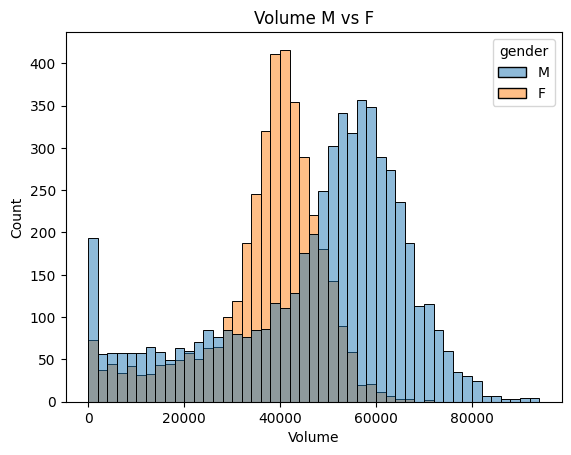

In [83]:
create_seaborn_plot_scatterplot_gender('L1 vertebra', 'Volume')

idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table


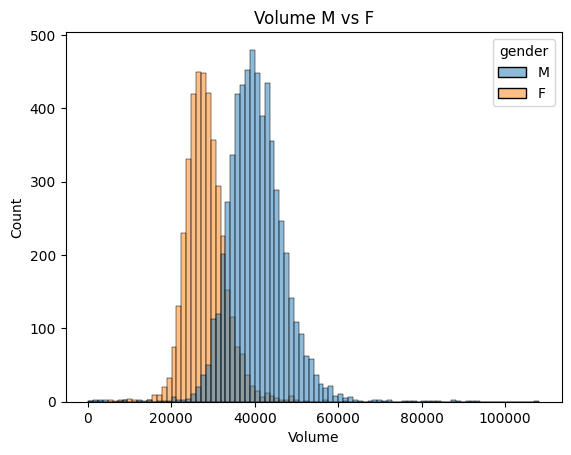

In [88]:
create_seaborn_plot_scatterplot_gender("T9 vertebra", "Volume")

## Scatter plot of M vs F with regression lines of Age vs featurea and region

In [90]:
def create_seaborn_plot_scatterplot_age(region, feature):

  client = bigquery.Client(project=project_name)
  print(table_id)

  query = f"""

  SELECT
     DISTINCT(SOPInstanceUID),
     age,
     gender,
     Value
  FROM
    `idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table`
  WHERE
      findingSite.CodeMeaning = @region AND
      Quantity.CodeMeaning = @feature;
  """

  job_config = bigquery.QueryJobConfig(query_parameters=[
                                                        bigquery.ScalarQueryParameter("region", "STRING", region),
                                                        bigquery.ScalarQueryParameter("feature", "STRING", feature)
                                                        ])
  df = client.query(query, job_config=job_config).to_dataframe()

  df['age'] = df['age'].astype('float64')
  df['Value'] = df['Value'].astype('float64')
  scatterplot = sns.lmplot(data=df, x="age", y="Value", hue="gender", markers=["o", "x"], scatter_kws={"s": 1})
  scatterplot.set(xlabel ="age", ylabel = feature, title ='Age vs ' + feature + ' for M vs F')

  return

idc-external-025.terra.10k-series-data-061023-measurements-clinical-viewer_table


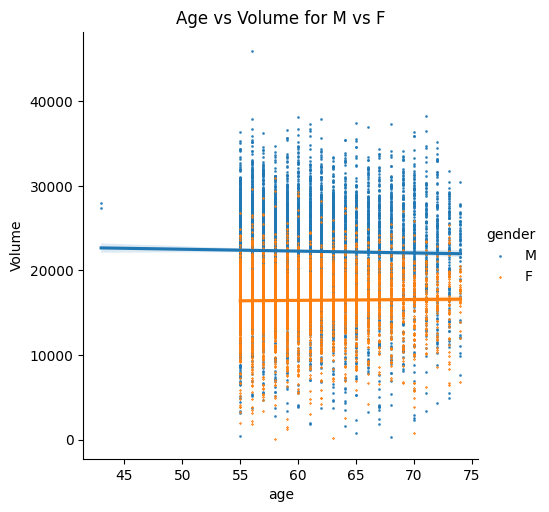

In [91]:
create_seaborn_plot_scatterplot_age("T1 vertebra", "Volume")